## import packages and color codes

In [48]:
import datetime

print("investigator: Thomas Walle\n")
print('date:')
print(datetime.datetime.now())

# Which python
import sys


investigator: Thomas Walle

date:
2021-09-13 17:20:06.798709


In [49]:
sys.path[2]

'/home/wallet/miniconda3/envs/2021_Peer_SPADE_pytorch_model/lib/python3.8'

In [50]:
# scanpy packages 
import scanpy as sc
import scanpy.external as sce
import anndata as anndata



# Laughney packages
from anndata import AnnData
import time
import os
import numpy as np
import seaborn as sns
import pandas as pd
import re
import h5py
from copy import deepcopy
import scipy.cluster.hierarchy as hc
import scipy as scipy
from scipy.stats import ttest_ind
from scipy.sparse import csr_matrix


import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.patches as patches
import matplotlib.colors as colors
import matplotlib.font_manager
from matplotlib import rcParams

%matplotlib inline

# other packages
import glob
from collections import OrderedDict
from scipy.sparse import csr_matrix
import scipy.stats
from statistics import median
from statistics import mean
from scanpy.external.pp import magic



In [51]:
# Before importing diffxpy.api or batchglm.api in your python session, execute:
import os
os.environ.setdefault("TF_NUM_THREADS", "1")
os.environ.setdefault("TF_LOOP_PARALLEL_ITERATIONS", "1")
import diffxpy.api as de

from colors import rgb, hex
import colors as colors
from kneed import KneeLocator
import doubletdetection
import gseapy as gp

ModuleNotFoundError: No module named 'diffxpy'

In [52]:
import pkg_resources
import types
def get_imports():
    for name, val in globals().items():
        if isinstance(val, types.ModuleType):
            # Split ensures you get root package, 
            # not just imported function
            name = val.__name__.split(".")[0]

        elif isinstance(val, type):
            name = val.__module__.split(".")[0]

        # Some packages are weird and have different
        # imported names vs. system/pip names. Unfortunately,
        # there is no systematic way to get pip names from
        # a package's imported name. You'll have to had
        # exceptions to this list manually!
        poorly_named_packages = {
            "PIL": "Pillow",
            "sklearn": "scikit-learn"
        }
        if name in poorly_named_packages.keys():
            name = poorly_named_packages[name]

        yield name
imports = list(set(get_imports()))

# The only way I found to get the version of the root package
# from only the name of the package is to cross-check the names 
# of installed packages vs. imported packages
requirements = []
for m in pkg_resources.working_set:
    if m.project_name in imports and m.project_name!="pip":
        requirements.append((m.project_name, m.version))

for r in requirements:
    print("{}=={}".format(*r))

seaborn==0.11.1
scipy==1.6.2
scanpy==1.8.1
pandas==1.3.0
numpy==1.20.3
matplotlib==3.3.4
h5py==3.3.0
anndata==0.7.6


In [53]:
# FUNCTIONS

# Randomize cells for plotting UMAP
def randomize_cells(anndata_object):
    
    "Randomize cells for plotting UMAP"
    
    index_list = np.arange(anndata_object.shape[0])
    np.random.shuffle(index_list)
    anndata_object = anndata_object[index_list]
    
    return anndata_object

In [54]:
# define colors

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=80, frameon=False, vector_friendly=True, fontsize=7, figsize=(10,10), color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')
sns.set_style('white')

color_map_clusters = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",
"#FFDBE5", "#7A4900", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

godsnot_64 = [
    # "#000000",  # remove the black, as often, we have black colored annotation
    "#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",
    "#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
    "#5A0007", "#809693", "#6A3A4C", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
    "#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
    "#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
    "#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
    "#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
    "#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
    "#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
    "#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
    "#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
    "#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
    "#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72"]

color_map_bimodal = ['#e1e1e1','#FF4A46']

color_map_clusters_plt = cm = LinearSegmentedColormap.from_list(
        'color_map_clusters', color_map_clusters[5:])

# normalize and cluster

## load data

In [7]:
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs.h5ad'
adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_reanalysis.h5ad'
pheno_k_list = [10,20,30,40,50,60,70,80,90,100]
pheno_name_list = ['pheno_k10','pheno_k20','pheno_k30','pheno_k40','pheno_k50','pheno_k60','pheno_k70',
                  'pheno_k80','pheno_k90','pheno_k100',]

In [8]:
adata_nodrops_nodub = sc.read(adata_path)

In [9]:
print(adata_nodrops_nodub.X)

  (0, 2)	0.9001564
  (0, 76)	0.9001564
  (0, 108)	0.9001564
  (0, 475)	0.9001564
  (0, 524)	1.9227805
  (0, 549)	0.9001564
  (0, 560)	0.9001564
  (0, 579)	1.6826816
  (0, 664)	1.3660854
  (0, 665)	0.9001564
  (0, 697)	0.9001564
  (0, 698)	0.9001564
  (0, 722)	0.9001564
  (0, 783)	0.9001564
  (0, 826)	1.3660854
  (0, 884)	0.9001564
  (0, 951)	0.9001564
  (0, 994)	0.9001564
  (0, 999)	0.9001564
  (0, 1107)	0.9001564
  (0, 1109)	0.9001564
  (0, 1186)	0.9001564
  (0, 1200)	0.9001564
  (0, 1259)	1.3660854
  (0, 1264)	1.3660854
  :	:
  (152990, 19554)	1.2343922
  (152990, 19563)	1.2343922
  (152990, 19582)	1.2343922
  (152990, 19585)	1.2343922
  (152990, 19663)	1.2343922
  (152990, 19714)	1.2343922
  (152990, 19781)	1.2343922
  (152990, 19790)	1.7702938
  (152990, 19802)	1.2343922
  (152990, 19824)	1.2343922
  (152990, 19830)	2.5788102
  (152990, 19931)	1.2343922
  (152990, 19936)	1.2343922
  (152990, 19949)	1.2343922
  (152990, 20074)	1.2343922
  (152990, 20181)	1.2343922
  (152990, 20200)	

In [10]:
#attach raw counts
adata_subset = adata_nodrops_nodub.raw[adata_nodrops_nodub.obs_names, adata_nodrops_nodub.var_names]
adata_nodrops_nodub.X = adata_subset.X

In [12]:
print(adata_nodrops_nodub.X)

  (0, 14082)	1.0
  (0, 14771)	1.0
  (0, 11063)	1.0
  (0, 20463)	1.0
  (0, 6176)	1.0
  (0, 11956)	2.0
  (0, 19441)	2.0
  (0, 13602)	1.0
  (0, 7185)	1.0
  (0, 17547)	1.0
  (0, 5321)	1.0
  (0, 17316)	1.0
  (0, 8162)	6.0
  (0, 1200)	1.0
  (0, 9892)	115.0
  (0, 11098)	8.0
  (0, 10891)	1.0
  (0, 10614)	1.0
  (0, 7523)	1.0
  (0, 2316)	1.0
  (0, 1301)	1.0
  (0, 1628)	1.0
  (0, 16029)	2.0
  (0, 1271)	4.0
  (0, 13120)	1.0
  :	:
  (152990, 16406)	1.0
  (152990, 1376)	1.0
  (152990, 4663)	1.0
  (152990, 13105)	1.0
  (152990, 19790)	2.0
  (152990, 5806)	1.0
  (152990, 18773)	3.0
  (152990, 1380)	1.0
  (152990, 7117)	2.0
  (152990, 1436)	1.0
  (152990, 2995)	1.0
  (152990, 12539)	1.0
  (152990, 3013)	4.0
  (152990, 16812)	3.0
  (152990, 3587)	2.0
  (152990, 19452)	1.0
  (152990, 16076)	1.0
  (152990, 10832)	1.0
  (152990, 9780)	1.0
  (152990, 8558)	2.0
  (152990, 13766)	1.0
  (152990, 8790)	1.0
  (152990, 6274)	1.0
  (152990, 13599)	1.0
  (152990, 3309)	1.0


## QC metrics

In [13]:
#check if .raw element still intact
print('raw element shape=', adata_nodrops_nodub.raw.X.shape)
print('processed adata shape=', adata_nodrops_nodub.X.shape)

raw element shape= (152991, 24817)
processed adata shape= (152991, 20962)


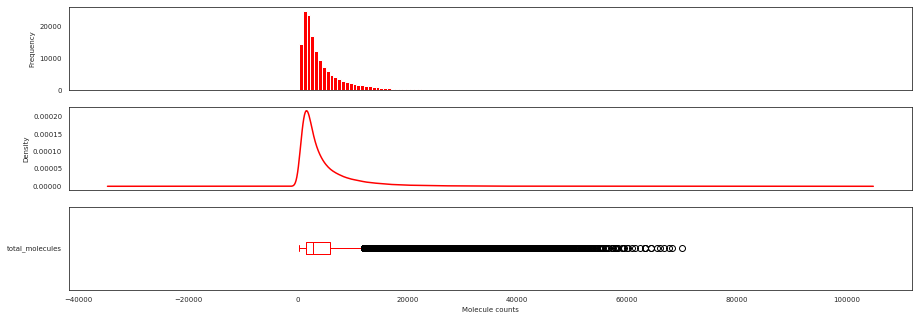

In [14]:
%matplotlib inline
#calculate total molecules
# PLot counts
a = adata_nodrops_nodub.copy()
a.obs["total_molecules"] = np.sum(a.X, axis=1)

# Per cell (Total molecules per cell)
fig, (ax1, ax2, ax3) = plt.subplots(nrows=3,
                                    ncols=1,
                                    sharex=True,
                                    figsize=(15, 5))
a.obs["total_molecules"][a.obs["total_molecules"] != 0].plot(kind="hist",
                                                             bins=100,
                                                             ax=ax1,
                                                             color="r")
a.obs["total_molecules"][a.obs["total_molecules"] != 0].plot(kind="kde",
                                                             ax=ax2,
                                                             color="r")
a.obs["total_molecules"][a.obs["total_molecules"] != 0].plot(kind="box",
                                                             vert=False,
                                                             ax=ax3,
                                                             color="r")
x = ax3.set_xlabel("Molecule counts")

## log1p normalize

In [15]:
#total count normalization
sc.pp.normalize_total(adata_nodrops_nodub, target_sum=None)
#logarithmize +1 the data
sc.pp.log1p(adata_nodrops_nodub)

In [16]:
print(adata_nodrops_nodub.X)

  (0, 14082)	1.0094328
  (0, 14771)	1.0094328
  (0, 11063)	1.0094328
  (0, 20463)	1.0094328
  (0, 6176)	1.0094328
  (0, 11956)	1.5014267
  (0, 19441)	1.5014267
  (0, 13602)	1.0094328
  (0, 7185)	1.0094328
  (0, 17547)	1.0094328
  (0, 5321)	1.0094328
  (0, 17316)	1.0094328
  (0, 8162)	2.4392347
  (0, 1200)	1.0094328
  (0, 9892)	5.3061123
  (0, 11098)	2.7048686
  (0, 10891)	1.0094328
  (0, 10614)	1.0094328
  (0, 7523)	1.0094328
  (0, 2316)	1.0094328
  (0, 1301)	1.0094328
  (0, 1628)	1.0094328
  (0, 16029)	1.5014267
  (0, 1271)	2.0764592
  (0, 13120)	1.0094328
  :	:
  (152990, 16406)	1.363613
  (152990, 1376)	1.363613
  (152990, 4663)	1.363613
  (152990, 13105)	1.363613
  (152990, 19790)	1.9199462
  (152990, 5806)	1.363613
  (152990, 18773)	2.275305
  (152990, 1380)	1.363613
  (152990, 7117)	1.9199462
  (152990, 1436)	1.363613
  (152990, 2995)	1.363613
  (152990, 12539)	1.363613
  (152990, 3013)	2.53696
  (152990, 16812)	2.275305
  (152990, 3587)	1.9199462
  (152990, 19452)	1.363613
  (15

In [17]:
#check if raw element still intact
print(adata_nodrops_nodub.raw.X)

  (0, 16154)	1.0
  (0, 17325)	1.0
  (0, 12779)	1.0
  (0, 24301)	1.0
  (0, 7167)	1.0
  (0, 13824)	2.0
  (0, 23207)	2.0
  (0, 15562)	1.0
  (0, 8281)	1.0
  (0, 21122)	1.0
  (0, 6270)	1.0
  (0, 20863)	1.0
  (0, 9379)	6.0
  (0, 1649)	1.0
  (0, 11531)	115.0
  (0, 12814)	8.0
  (0, 12600)	1.0
  (0, 12298)	1.0
  (0, 8643)	1.0
  (0, 2844)	1.0
  (0, 1755)	1.0
  (0, 2100)	1.0
  (0, 19503)	2.0
  (0, 1725)	4.0
  (0, 15063)	1.0
  :	:
  (152990, 19905)	1.0
  (152990, 1831)	1.0
  (152990, 5565)	1.0
  (152990, 15047)	1.0
  (152990, 23580)	2.0
  (152990, 6770)	1.0
  (152990, 22437)	3.0
  (152990, 1836)	1.0
  (152990, 8202)	2.0
  (152990, 1895)	1.0
  (152990, 3578)	1.0
  (152990, 14427)	1.0
  (152990, 3596)	4.0
  (152990, 20329)	3.0
  (152990, 4226)	2.0
  (152990, 23220)	1.0
  (152990, 19550)	1.0
  (152990, 12540)	1.0
  (152990, 11395)	1.0
  (152990, 9817)	2.0
  (152990, 15741)	1.0
  (152990, 10059)	1.0
  (152990, 7273)	1.0
  (152990, 15559)	1.0
  (152990, 3905)	1.0


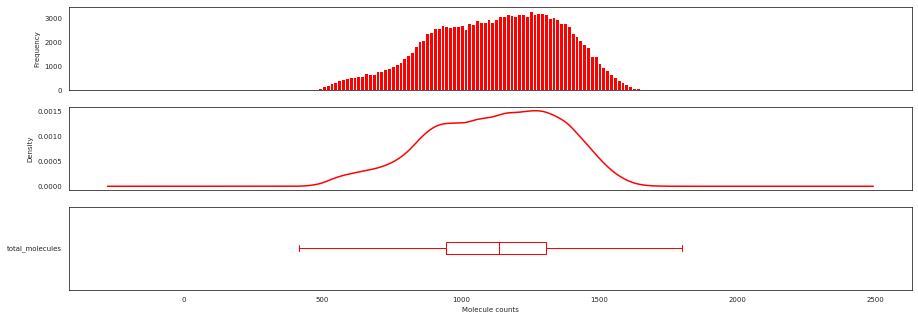

In [18]:
# PLot counts
a = adata_nodrops_nodub.copy()
a.obs["total_molecules"] = np.sum(a.X, axis=1)
# Per cell (Total molecules per cell)
fig, (ax1, ax2, ax3) = plt.subplots(nrows=3,
                                    ncols=1,
                                    sharex=True,
                                    figsize=(15, 5))
a.obs["total_molecules"][a.obs["total_molecules"] != 0].plot(kind="hist",
                                                             bins=100,
                                                             ax=ax1,
                                                             color="r")
a.obs["total_molecules"][a.obs["total_molecules"] != 0].plot(kind="kde",
                                                             ax=ax2,
                                                             color="r")
a.obs["total_molecules"][a.obs["total_molecules"] != 0].plot(kind="box",
                                                             vert=False,
                                                             ax=ax3,
                                                             color="r")
x = ax3.set_xlabel("Molecule counts")

## recalculate PCs and neighbours 

In [19]:
#check if log1p norm
print(adata_nodrops_nodub.X)

  (0, 14082)	1.0094328
  (0, 14771)	1.0094328
  (0, 11063)	1.0094328
  (0, 20463)	1.0094328
  (0, 6176)	1.0094328
  (0, 11956)	1.5014267
  (0, 19441)	1.5014267
  (0, 13602)	1.0094328
  (0, 7185)	1.0094328
  (0, 17547)	1.0094328
  (0, 5321)	1.0094328
  (0, 17316)	1.0094328
  (0, 8162)	2.4392347
  (0, 1200)	1.0094328
  (0, 9892)	5.3061123
  (0, 11098)	2.7048686
  (0, 10891)	1.0094328
  (0, 10614)	1.0094328
  (0, 7523)	1.0094328
  (0, 2316)	1.0094328
  (0, 1301)	1.0094328
  (0, 1628)	1.0094328
  (0, 16029)	1.5014267
  (0, 1271)	2.0764592
  (0, 13120)	1.0094328
  :	:
  (152990, 16406)	1.363613
  (152990, 1376)	1.363613
  (152990, 4663)	1.363613
  (152990, 13105)	1.363613
  (152990, 19790)	1.9199462
  (152990, 5806)	1.363613
  (152990, 18773)	2.275305
  (152990, 1380)	1.363613
  (152990, 7117)	1.9199462
  (152990, 1436)	1.363613
  (152990, 2995)	1.363613
  (152990, 12539)	1.363613
  (152990, 3013)	2.53696
  (152990, 16812)	2.275305
  (152990, 3587)	1.9199462
  (152990, 19452)	1.363613
  (15

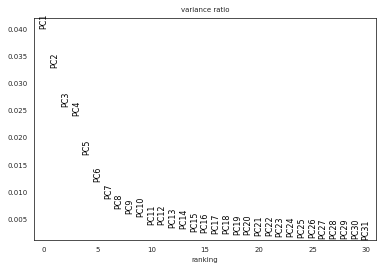

In [20]:
#PCA
sc.pp.pca(adata_nodrops_nodub, n_comps=100, zero_center=True, svd_solver='arpack', random_state=0, return_info=False, use_highly_variable=None, dtype='float32', copy=False, chunked=False, chunk_size=None)
sc.pl.pca_variance_ratio(adata_nodrops_nodub, log=False)

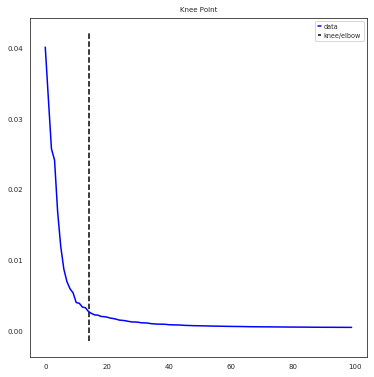

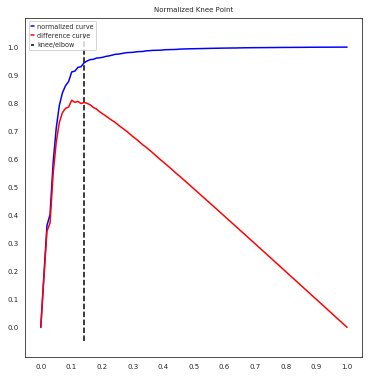

Kneepoint happens at PC: 14
14 PC explain 19.30487780315156 % of variance


In [21]:
a = adata_nodrops_nodub.copy()# PCs kneepoint
x = [i for i in range(len(a.uns["pca"]["variance_ratio"]))]
y = list(a.uns["pca"]["variance_ratio"])
kneedle = KneeLocator(x,
                      y,
                      S=1,
                      curve='convex',
                      direction='decreasing',
                      online=False)
kn_pc = round(kneedle.knee, 3)
kneedle.plot_knee()
plt.show()
kneedle.plot_knee_normalized()
plt.show()
print("Kneepoint happens at PC:", kn_pc)

exp_var = sum(adata_nodrops_nodub.uns['pca']['variance_ratio'][:kn_pc])
exp_var_test_percent = exp_var*100
print(kn_pc,'PC explain',exp_var_test_percent, '% of variance')

### set number of PCs

In [22]:
#find number of PCs explaining at least 20% of variance
tested_PC_number = kn_pc

while exp_var_test_percent <20:
    tested_PC_number = tested_PC_number+1
    exp_var_test = sum(adata_nodrops_nodub.uns['pca']['variance_ratio'][0:tested_PC_number])
    exp_var_test_percent = exp_var_test*100
    print(tested_PC_number, 'PC explain',exp_var_test_percent, '% of variance')

15 PC explain 19.57443130824315 % of variance
16 PC explain 19.81707901296035 % of variance
17 PC explain 20.04086321495469 % of variance


### cluster and impute

In [23]:
#if other PC number than kneepoint should be used define here
number_of_PC_used = tested_PC_number
print('number of PCs for clusterings/embeddings is:', number_of_PC_used)

number of PCs for clusterings/embeddings is: 17


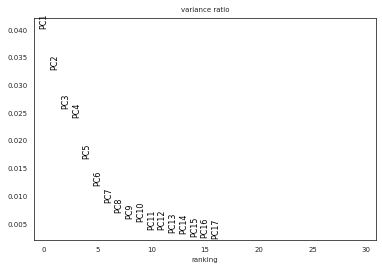

In [24]:
sc.tl.pca(adata_nodrops_nodub, svd_solver='arpack',n_comps= number_of_PC_used, use_highly_variable=False) 
sc.pl.pca_variance_ratio(adata_nodrops_nodub,log=False)

In [25]:
sc.pp.neighbors(adata_nodrops_nodub, n_neighbors=15, n_pcs=number_of_PC_used)
sc.tl.umap(adata_nodrops_nodub)

In [26]:
#phenograph
for i,v in enumerate(pheno_k_list):
    print('calulating PhenoGraph with parameter k=', v)
    result_pheno_nodropdub_all = sce.tl.phenograph(adata_nodrops_nodub.obsm['X_pca'], k = v)
    adata_nodrops_nodub.obs[pheno_name_list[i]] = pd.Categorical(result_pheno_nodropdub_all[0])
    print('saved PhenoGraph clusters with k=', v, 'under', pheno_name_list[i])

calulating PhenoGraph with parameter k= 10
Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 645.5555503368378 seconds
Jaccard graph constructed in 34.627469062805176 seconds
Wrote graph to binary file in 4.455143690109253 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.937344
Louvain completed 21 runs in 42.56802725791931 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 753.5507321357727 seconds
saved PhenoGraph clusters with k= 10 under pheno_k10
calulating PhenoGraph with parameter k= 20
Finding 20 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 634.7596161365509 seconds
Jaccard graph constructed in 47.17009115219116 seconds
Wrote graph to binary file in 10.963992595672607 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.922077
After 8 runs, maximum modularity is Q = 0.923143
Louvain completed 

In [27]:
#impute data
from scanpy.external.pp import magic
adata_nodrops_nodub_imputed = magic(adata_nodrops_nodub, copy=True, verbose=True, n_pca=adata_nodrops_nodub.obsm['X_pca'].shape[1], knn=5, t=3, solver='approximate')
adata_nodrops_nodub.layers['imputed'] = adata_nodrops_nodub_imputed.X

Calculating MAGIC...
  Running MAGIC on 152991 cells and 20962 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 56.22 seconds.
    Calculating KNN search...
    Calculated KNN search in 251.85 seconds.
    Calculating affinities...
    Calculated affinities in 329.80 seconds.
  Calculated graph and diffusion operator in 638.35 seconds.


/home/wallet/.local/lib/python3.8/site-packages/magic/magic.py:500: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  and isinstance(X, (pd.SparseDataFrame, sparse.spmatrix))


  Calculating imputation...
  Calculated imputation in 0.43 seconds.


/home/wallet/.local/lib/python3.8/site-packages/magic/utils.py:135: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  if isinstance(target_data, pd.SparseDataFrame):


Calculated MAGIC in 664.43 seconds.


In [28]:
#save data
adata_nodrops_nodub.write(adata_save_path)

## plot cleaned data 

In [56]:
#set parameters
%matplotlib inline
imputed = False
continue_with_adata = False #load new adata indicated by paths below or continue with loaded adata object

#adata paths
#adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_reanalysis.h5ad'
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210216_reanalysis.h5ad'
#adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_7500hv_genes_curated_marker_genes_210216_reanalysis.h5ad'
#marker genes
TILC_genes = ['CD3D','CD3E','CD4','CD8A','TRAC','TRBC1','TRDC','FOXP3','IL2RA','NCR1','KLRB1C','ICOS','KIT','THY1']
B_genes = ['MS4A1','CD19','CD27','SDC1','AICDA','IGHD','IGHM','IGHG1','IGHG2B','IGHG2C','IGHA']
M_genes = ['CD68','MRC1','CD14','FUT4','CSF3R','CXCR1','HDC','ID2','BATF3','IRF8','TCF4','IRF4','CD207']
epi_mes_endo_genes = ['CSPG4', 'MCAM', 'NES','ACTA1','ACTA2','CDH5','CALD1', 'CNN1','HEXIM1', 'HRH2', 'TAGLN', 'MYH11', 'LRRN4','EPCAM','MCAM','NES','FLT1','PECAM1','ESAM','JAM2','FLT4','CHD5','VIM','COL3A1','COL1A2','GLP1R','GLPR2R','GHRL','SST','IAPP','INS','GCG','PPY',
                      'CPA1', 'ZG16', 'PTF1A', 'NR5A2', 'TRY4', 'TRY5', 'TRY10','REG3B','REG2','CTRB1','PRSS2',
                      'SOX9', 'MMP7', 'KRT19','DES', 'DCN', 'TWIST1', 'TWIST2', 'SNAI1', 'SNAI2', 'COL1A1', 'ACTA2',
                      'MUC6', 'TFF2', 'TFF1', 'AGR2', 'CLU', 'MUC5','NEUROD1', 'CHGA', 'GCN','GCG','INS1','INS2','PPY','SST']
marker_genes = [TILC_genes, B_genes, M_genes, epi_mes_endo_genes]
pheno_names = ['pheno_var_k10','pheno_var_k20','pheno_var_k30','pheno_var_k40','pheno_var_k50','pheno_var_k60','pheno_var_k70',
              'pheno_var_k80','pheno_var_k90','pheno_var_k100']
#pheno_names = ['pheno_k10','pheno_k20','pheno_k30','pheno_k40','pheno_k50','pheno_k60','pheno_k70',
#             'pheno_k80','pheno_k90','pheno_k100']

In [57]:
#load AnnData object
if continue_with_adata == False:
    adata = sc.read(adata_path)

In [58]:
# Filter out genes not present in single cell data

marker_genes_filtered = []
for i,v in enumerate(marker_genes):
    markers = []
    for gene in v:
        if gene in adata.var.index:   
            markers.append(gene)
        else:
            print(gene + ' filtered out')
        markers = list(set(markers))
    marker_genes_filtered.append(markers)
        

KLRB1C filtered out
IGHG2B filtered out
IGHG2C filtered out
IGHA filtered out
GLPR2R filtered out
TRY4 filtered out
TRY5 filtered out
TRY10 filtered out
REG3B filtered out
REG2 filtered out
MUC5 filtered out
GCN filtered out
INS1 filtered out
INS2 filtered out


In [59]:
marker_genes_filtered

[['THY1',
  'CD4',
  'CD3E',
  'IL2RA',
  'FOXP3',
  'CD3D',
  'NCR1',
  'TRAC',
  'CD8A',
  'KIT',
  'ICOS',
  'TRDC',
  'TRBC1'],
 ['SDC1', 'MS4A1', 'IGHM', 'AICDA', 'IGHD', 'IGHG1', 'CD19', 'CD27'],
 ['CD14',
  'CXCR1',
  'HDC',
  'IRF4',
  'FUT4',
  'IRF8',
  'TCF4',
  'CD207',
  'BATF3',
  'CD68',
  'MRC1',
  'CSF3R',
  'ID2'],
 ['HEXIM1',
  'CALD1',
  'GCG',
  'IAPP',
  'NR5A2',
  'SST',
  'FLT4',
  'MUC6',
  'CTRB1',
  'HRH2',
  'MYH11',
  'SNAI1',
  'NEUROD1',
  'EPCAM',
  'GHRL',
  'INS',
  'MMP7',
  'ACTA1',
  'CDH5',
  'TAGLN',
  'KRT19',
  'ACTA2',
  'PTF1A',
  'CHGA',
  'GLP1R',
  'PRSS2',
  'TWIST2',
  'MCAM',
  'COL1A2',
  'NES',
  'SOX9',
  'SNAI2',
  'CNN1',
  'ZG16',
  'TWIST1',
  'CSPG4',
  'DCN',
  'TFF2',
  'DES',
  'COL1A1',
  'PECAM1',
  'COL3A1',
  'VIM',
  'PPY',
  'ESAM',
  'TFF1',
  'CHD5',
  'FLT1',
  'JAM2',
  'AGR2',
  'CLU',
  'CPA1',
  'LRRN4']]

In [60]:
#imputed variable serves to define option in sc.pl.umap function

if imputed == True:
    select_layer = 'imputed'
else:
    select_layer = None

In [61]:
adata

AnnData object with n_obs × n_vars = 152991 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'v

Trying to set attribute `.uns` of view, copying.


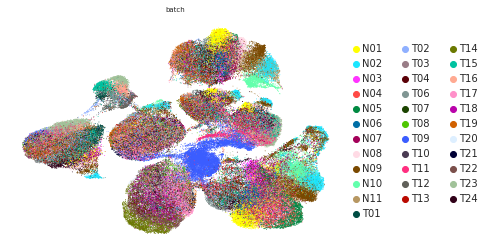

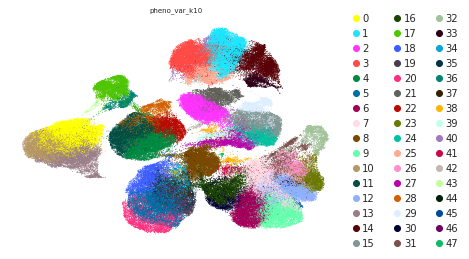

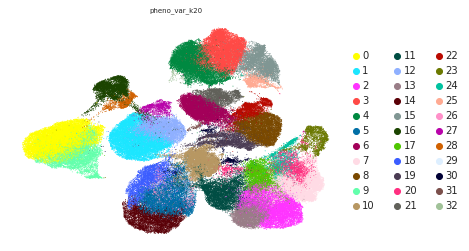

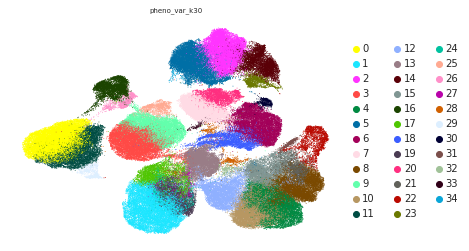

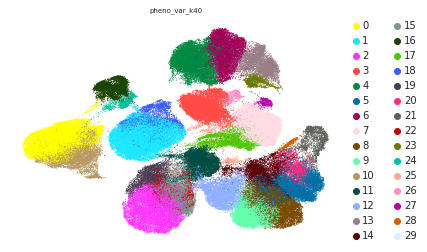

...

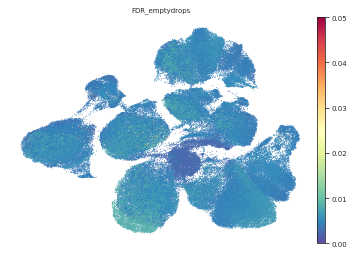

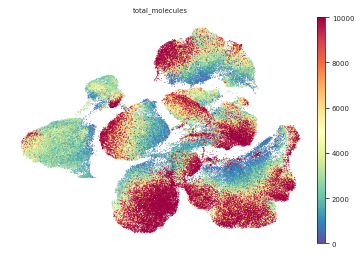

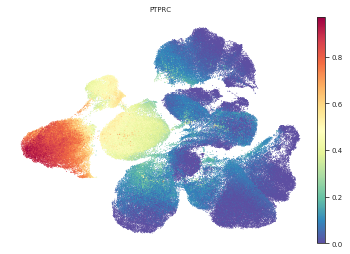

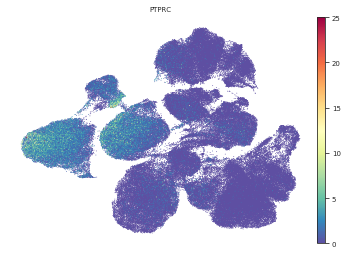

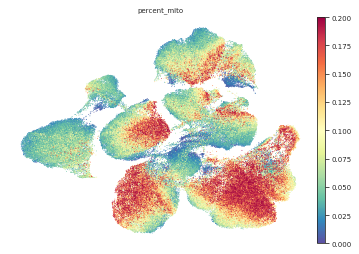

In [62]:
#plot umap

##randomize cells
adata = randomize_cells(adata)

##set style
%matplotlib inline
sns.set_style('white')

##plot
sc.pl.umap(adata, color = ['batch'], s = 3, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
for i in pheno_names:
    sc.pl.umap(adata, color = [i], s = 3, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['FDR_emptydrops'], s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0,vmax=0.05)
sc.pl.umap(adata, color = ['total_molecules'], s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0, vmax=10000)
sc.pl.umap(adata, color = ['PTPRC'], s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0, layer='imputed')
sc.pl.umap(adata, color = ['PTPRC'], s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['percent_mito'], s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0, vmax=0.2)

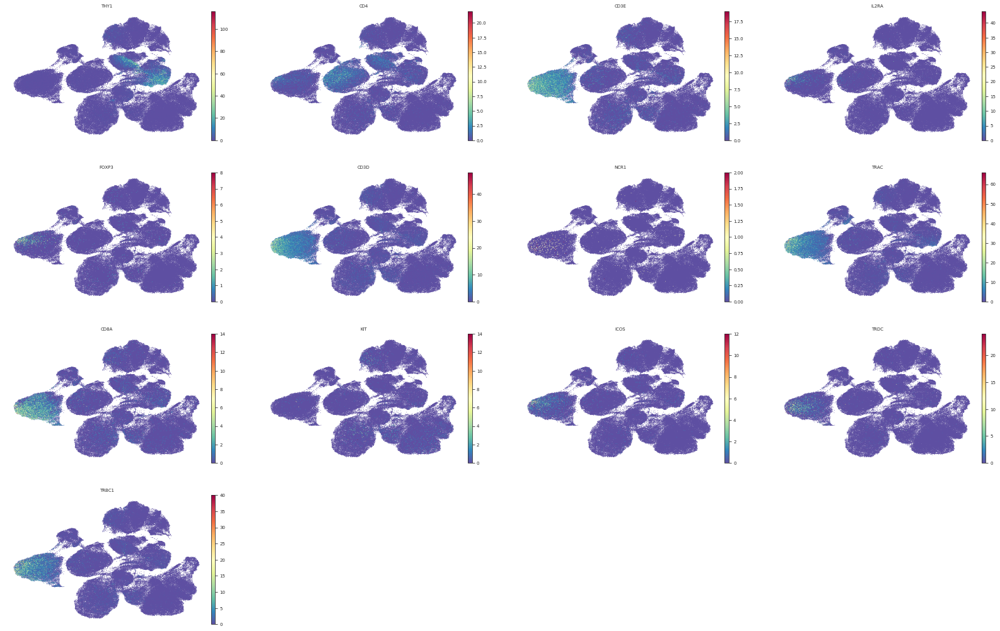

In [63]:
sc.pl.umap(adata, color = marker_genes_filtered[0],layer= select_layer, s = 3, cmap= 'Spectral_r',legend_fontsize = 10, vmin=0)

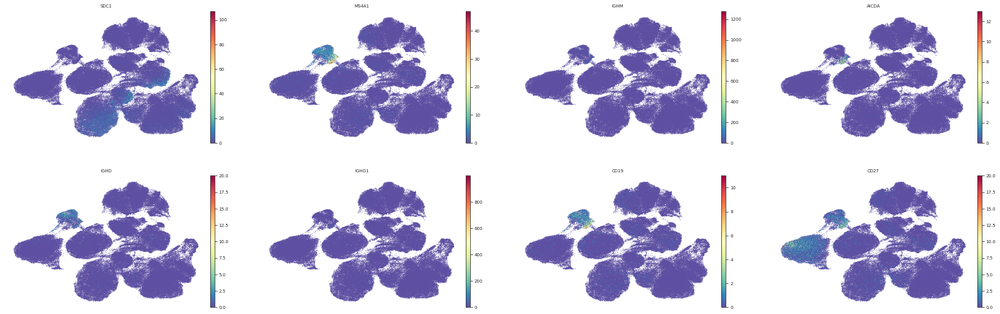

In [64]:
sc.pl.umap(adata, color = marker_genes_filtered[1], s = 3, cmap= 'Spectral_r', layer=select_layer, legend_fontsize = 10, vmin=0)

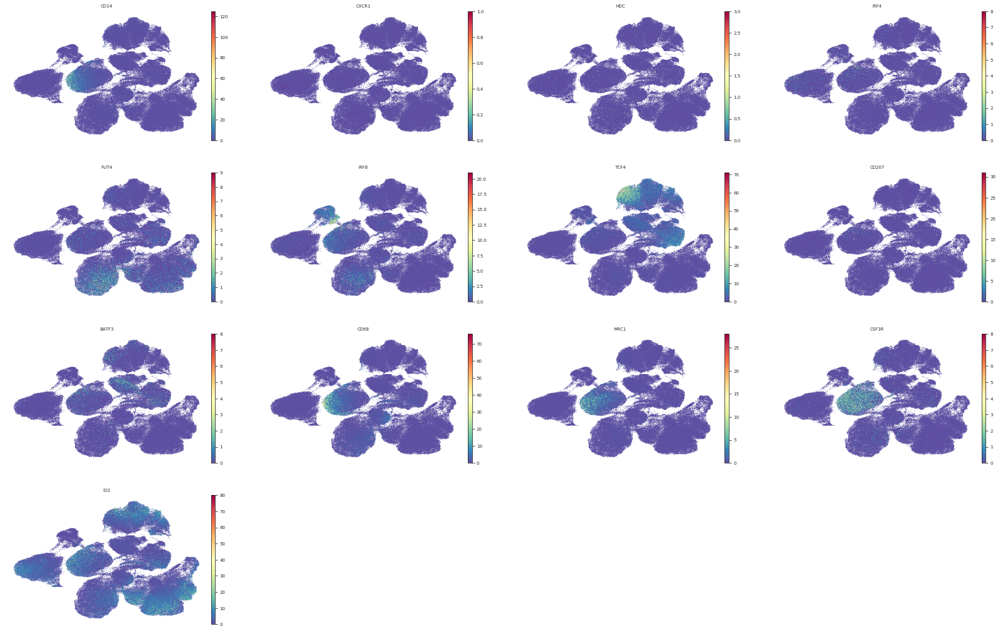

In [65]:
sc.pl.umap(adata, color = marker_genes_filtered[2], s = 3, cmap= 'Spectral_r',layer=select_layer, legend_fontsize = 10, vmin=0)

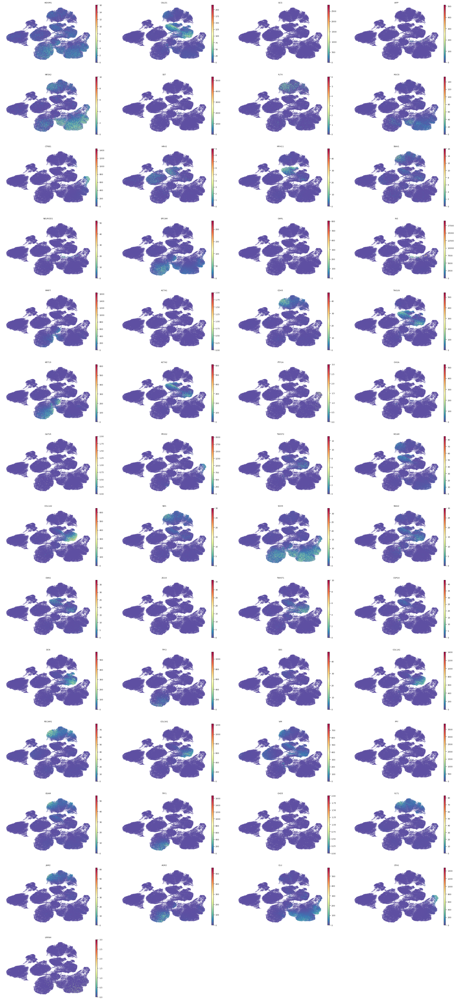

In [66]:
sc.pl.umap(adata, color = marker_genes_filtered[3], s = 3, cmap= 'Spectral_r',layer=select_layer, legend_fontsize = 10, vmin=0)

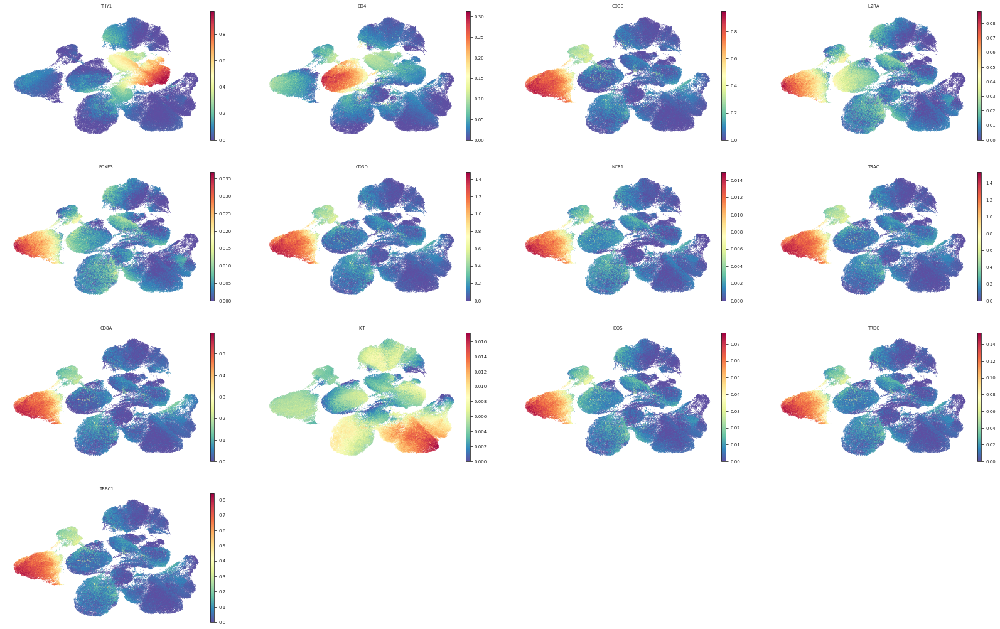

In [67]:
sc.pl.umap(adata, color = marker_genes_filtered[0],layer= 'imputed', s = 3, cmap= 'Spectral_r',legend_fontsize = 10, vmin=0)

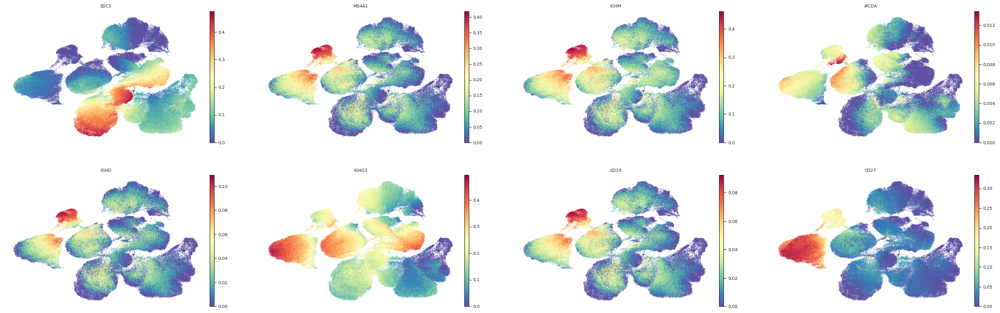

In [68]:
sc.pl.umap(adata, color = marker_genes_filtered[1], s = 3, cmap= 'Spectral_r', layer='imputed', legend_fontsize = 10, vmin=0)

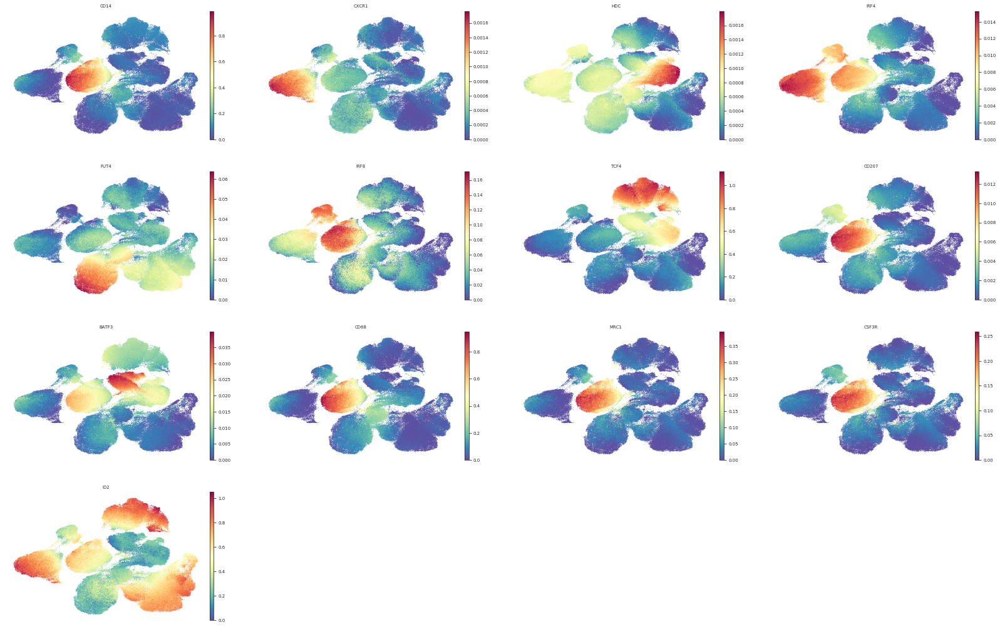

In [69]:
sc.pl.umap(adata, color = marker_genes_filtered[2], s = 3, cmap= 'Spectral_r',layer='imputed', legend_fontsize = 10, vmin=0)

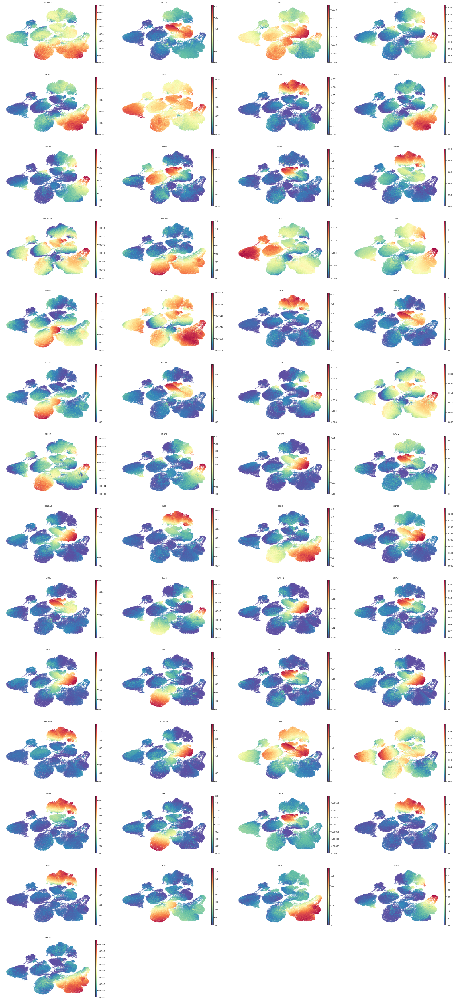

In [70]:
sc.pl.umap(adata, color = marker_genes_filtered[3], s = 3, cmap= 'Spectral_r',layer='imputed', legend_fontsize = 10, vmin=0)

# recalculate neighbors and PCs (highly variable genes, rerun with 10k,7.5k,5k top HV genes)

In [12]:
#set variables
pheno_k10_name = 'pheno_var_k10'
pheno_k20_name = 'pheno_var_k20'
pheno_k30_name = 'pheno_var_k30'
pheno_k40_name = 'pheno_var_k40'
pheno_k50_name = 'pheno_var_k50'
pheno_k60_name = 'pheno_var_k60'
pheno_k70_name = 'pheno_var_k70'
pheno_k80_name = 'pheno_var_k80'
pheno_k90_name = 'pheno_var_k90'
pheno_k100_name = 'pheno_var_k100'

continue_with_adata = False
save_adata = True
number_of_hv_genes = 7500
add_marker_genes = True
marker_gene_path = '/data/peer/wallet/Jupyter/PDAC_RT_Huber_Walle/immune_marker_panel_clean_210216.csv'
#set data paths
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_reanalysis.h5ad'
adata_highlyvar_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_7500hv_genes_curated_marker_genes_210216_reanalysis.h5ad'

In [13]:
#load adata
if continue_with_adata == False:
    adata = sc.read(adata_path)

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_reanalysis.h5ad', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [9]:
adata

AnnData object with n_obs × n_vars = 152991 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'Limited_colors', 'batch_colors', 'doublets_colors', 'neighbors', 'pca', 'pheno_colors', 'true_cell_emptydrops_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'imputed'
    obsp: 'connectivities',

# assign raw adata (needed for hv genes)

In [10]:
adata.layers['raw'] = adata.raw[adata.obs_names, adata.var_names].X

In [11]:
print(adata.X)

  (0, 14082)	1.0094328
  (0, 14771)	1.0094328
  (0, 11063)	1.0094328
  (0, 20463)	1.0094328
  (0, 6176)	1.0094328
  (0, 11956)	1.5014267
  (0, 19441)	1.5014267
  (0, 13602)	1.0094328
  (0, 7185)	1.0094328
  (0, 17547)	1.0094328
  (0, 5321)	1.0094328
  (0, 17316)	1.0094328
  (0, 8162)	2.4392347
  (0, 1200)	1.0094328
  (0, 9892)	5.3061123
  (0, 11098)	2.7048686
  (0, 10891)	1.0094328
  (0, 10614)	1.0094328
  (0, 7523)	1.0094328
  (0, 2316)	1.0094328
  (0, 1301)	1.0094328
  (0, 1628)	1.0094328
  (0, 16029)	1.5014267
  (0, 1271)	2.0764592
  (0, 13120)	1.0094328
  :	:
  (152990, 16406)	1.363613
  (152990, 1376)	1.363613
  (152990, 4663)	1.363613
  (152990, 13105)	1.363613
  (152990, 19790)	1.9199462
  (152990, 5806)	1.363613
  (152990, 18773)	2.275305
  (152990, 1380)	1.363613
  (152990, 7117)	1.9199462
  (152990, 1436)	1.363613
  (152990, 2995)	1.363613
  (152990, 12539)	1.363613
  (152990, 3013)	2.53696
  (152990, 16812)	2.275305
  (152990, 3587)	1.9199462
  (152990, 19452)	1.363613
  (15

In [12]:
print(adata.layers['raw'])

  (0, 14082)	1.0
  (0, 14771)	1.0
  (0, 11063)	1.0
  (0, 20463)	1.0
  (0, 6176)	1.0
  (0, 11956)	2.0
  (0, 19441)	2.0
  (0, 13602)	1.0
  (0, 7185)	1.0
  (0, 17547)	1.0
  (0, 5321)	1.0
  (0, 17316)	1.0
  (0, 8162)	6.0
  (0, 1200)	1.0
  (0, 9892)	115.0
  (0, 11098)	8.0
  (0, 10891)	1.0
  (0, 10614)	1.0
  (0, 7523)	1.0
  (0, 2316)	1.0
  (0, 1301)	1.0
  (0, 1628)	1.0
  (0, 16029)	2.0
  (0, 1271)	4.0
  (0, 13120)	1.0
  :	:
  (152990, 16406)	1.0
  (152990, 1376)	1.0
  (152990, 4663)	1.0
  (152990, 13105)	1.0
  (152990, 19790)	2.0
  (152990, 5806)	1.0
  (152990, 18773)	3.0
  (152990, 1380)	1.0
  (152990, 7117)	2.0
  (152990, 1436)	1.0
  (152990, 2995)	1.0
  (152990, 12539)	1.0
  (152990, 3013)	4.0
  (152990, 16812)	3.0
  (152990, 3587)	2.0
  (152990, 19452)	1.0
  (152990, 16076)	1.0
  (152990, 10832)	1.0
  (152990, 9780)	1.0
  (152990, 8558)	2.0
  (152990, 13766)	1.0
  (152990, 8790)	1.0
  (152990, 6274)	1.0
  (152990, 13599)	1.0
  (152990, 3309)	1.0


### select highly variable genes

In [13]:
sc.pp.highly_variable_genes(adata, layer='raw', flavor='seurat_v3', n_top_genes=number_of_hv_genes)

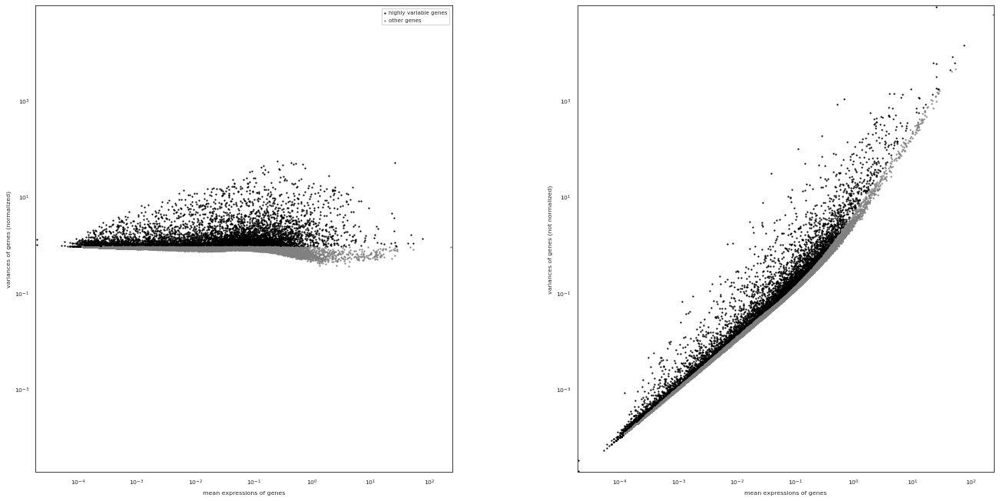

In [14]:
sc.pl.highly_variable_genes(adata, log=True, show=None, save=None, highly_variable_genes=True)

In [15]:
adata

AnnData object with n_obs × n_vars = 152991 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'Limited_colors', 'batch_colors', 'doublets_colors', 'neighbors', 'pca', 'pheno_colors', 'true_cell_emptydrops_colors', 'umap', 'hvg'
    obsm: 'X_

# add marker genes to highly variable

In [16]:
if add_marker_genes ==True:
    marker_genes_df = pd.read_csv(marker_gene_path, encoding='latin-1')

In [17]:
#limit to human only
marker_genes_df = marker_genes_df[marker_genes_df['species'] == 'homo_sapiens']

In [18]:
#limit to markers used for distinguishing immune from tumor cells
marker_genes_df = marker_genes_df[marker_genes_df['immune_typing_important_marker'] == True]

In [19]:
#extract gene names
marker_genes = list(set(marker_genes_df['gene_name']))

In [20]:
marker_genes

['C6',
 'ATXN1',
 'MIF',
 'CD79A',
 'CSF1',
 'CD3G',
 'IL12B',
 'CSF2RA',
 'CD33',
 'TCF3',
 'CLEC4C',
 'CR1',
 'XCR1',
 'TGFB1',
 'CCR7',
 'FCER1A',
 'IGHA1',
 'CD40',
 'SECISBP2L',
 'SPI1',
 'PIK3CD',
 'ENPP3',
 'CCL14',
 'CFI',
 'C8A',
 'C3',
 'FGFBP2',
 'HLA-DQB1',
 'CXCR1',
 'FCER1G',
 'CCL27',
 'PDCD1LG2',
 'HLA-DOB',
 'CCL11',
 'CD8B',
 'TNFRSF4',
 'IL7R',
 'CCL4',
 'GZMK',
 'S100A7',
 'NCAM1',
 'IFNAR2',
 'CXCL1',
 'CD14',
 'CX3CL1',
 'KIR2DL5B',
 'CD5',
 'SIRPA',
 'BATF3',
 'SOD2',
 'IFNGR1',
 'AHR',
 'IL3RA',
 'CD70',
 'LILRA2',
 'VSIR',
 'HLA-DRB4',
 'CFD',
 'IGHG4',
 'NR4A1',
 'RORC',
 'PDGFRB',
 'SELL',
 'KLRF1',
 'FAS',
 'GNLY',
 'TIGIT',
 'IL23R',
 'EGR2',
 'PRF1',
 'CD1C',
 'CD209',
 'VTCN1',
 'GPX2',
 'AICDA',
 'IL2RA',
 'LILRB4',
 'IL31',
 'IL18',
 'TFRC',
 'PTGDR2',
 'EOMES',
 'IGHA2',
 'IFNA7',
 'TFR2',
 'TRIM21',
 'TYRO3',
 'ACOD1',
 'MASP1',
 'IL25',
 'B3GAT1',
 'CEACAM1',
 'IL17RB',
 'IL27',
 'CCR2',
 'CCL20',
 'FCGR2C',
 'CEACAM8',
 'MPO',
 'ENTPD1',
 'TCF7',
 '

In [21]:
#set important marker genes as highly variable

for i in marker_genes:
    if i in adata.var_names:
        adata.var['highly_variable'][i]= True
    else:
        print(i, 'not found')

<ipython-input-21-622275f32bb2>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var['highly_variable'][i]= True


IL12B not found
KIR2DL5B not found
VSIR not found
HLA-DRB4 not found
IL31 not found
IFNA7 not found
ACOD1 not found
FCGR2C not found
CEACAM8 not found
IL3 not found
FCRLS not found
HLA-DRB3 not found
CCL24 not found
GPX5 not found
MBL2 not found
IFNA1 not found
ZBTB46  not found
CCL1 not found
GPX6 not found
TNFRSF13C  not found
ALK4 not found
TENT5C not found
IL22 not found
TREX1 not found
IFNA2 not found
IL21 not found
IFNA17 not found
TPSD1  not found
KIR2DL2 not found
TNFRSF9  not found
TACE not found
IL9 not found
SRCRB4D not found
S100A15 not found
IFNA8 not found
KIR3DL3 not found
KIR2DL5A not found
RAGE not found


### calculate PCs and cluster on highly variable genes

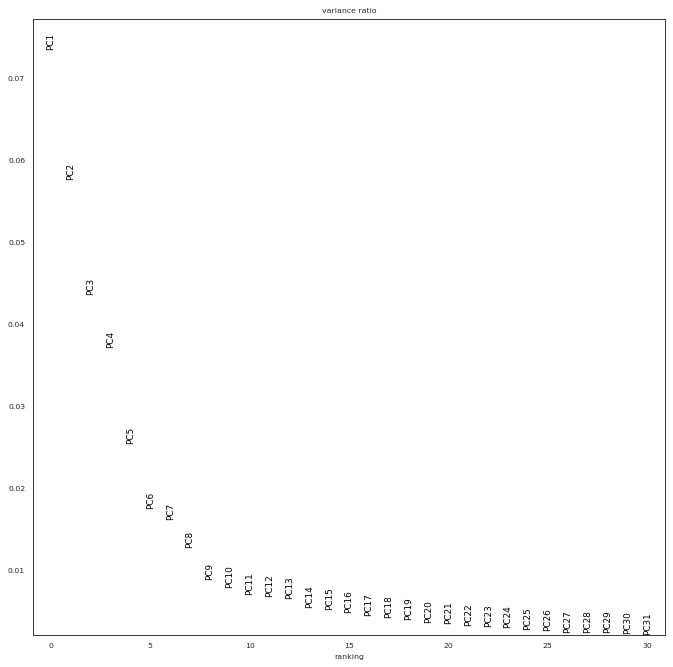

In [22]:
sc.tl.pca(adata, svd_solver='arpack',n_comps=100, use_highly_variable=True) 
sc.pl.pca_variance_ratio(adata,log=False)

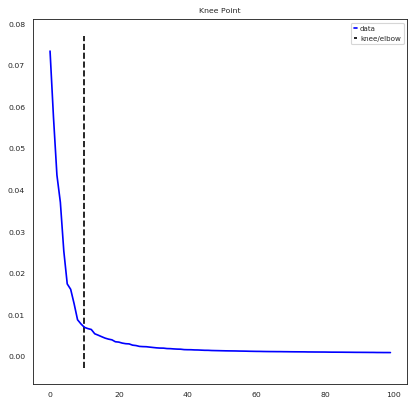

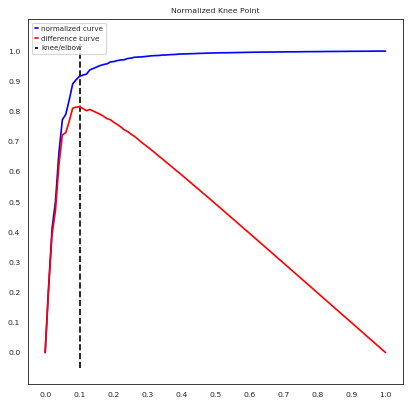

Kneepoint happens at PC: 10
10 PC explain 30.007534833552224 % of variance


In [23]:
a = adata.copy()# PCs kneepoint
x = [i for i in range(len(a.uns["pca"]["variance_ratio"]))]
y = list(a.uns["pca"]["variance_ratio"])
kneedle = KneeLocator(x,
                      y,
                      S=1,
                      curve='convex',
                      direction='decreasing',
                      online=False)
kn_pc = round(kneedle.knee, 3)
kneedle.plot_knee()
plt.show()
kneedle.plot_knee_normalized()
plt.show()
print("Kneepoint happens at PC:", kn_pc)

exp_var = sum(adata.uns['pca']['variance_ratio'][:kn_pc])
exp_var_test_percent = exp_var*100
print(kn_pc,'PC explain',exp_var_test_percent, '% of variance')

In [24]:
#find number of PCs explaining at least 20% of variance
tested_PC_number = kn_pc

while exp_var_test_percent <20:
    tested_PC_number = tested_PC_number+1
    exp_var_test = sum(adata.uns['pca']['variance_ratio'][0:tested_PC_number])
    exp_var_test_percent = exp_var_test*100
    print(tested_PC_number, 'PC explain',exp_var_test_percent, '% of variance')

### define the number of PCs to use

In [25]:
#if other PC number than kneepoint should be used define here
number_of_PC_used = tested_PC_number
print('number of PCs for clusterings/embeddings is:', number_of_PC_used)

number of PCs for clusterings/embeddings is: 10


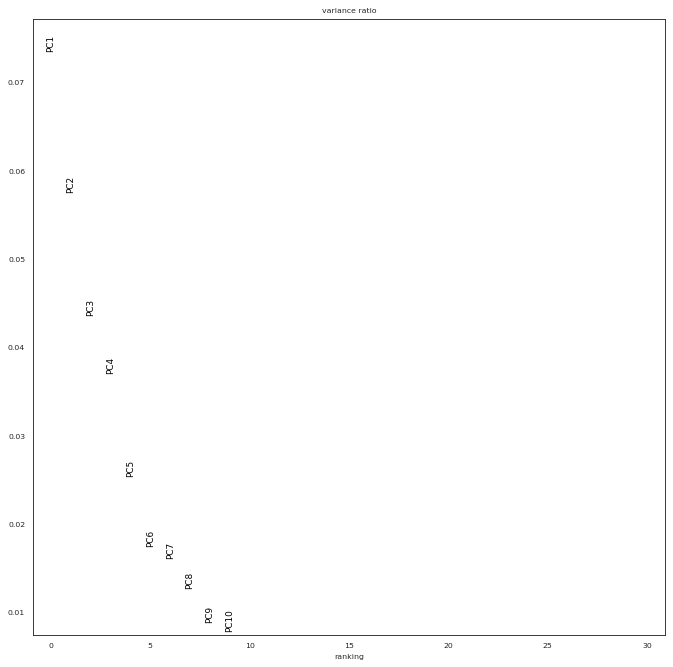

In [26]:
sc.tl.pca(adata, svd_solver='arpack',n_comps= number_of_PC_used, use_highly_variable=True) 
sc.pl.pca_variance_ratio(adata,log=False)

In [27]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=number_of_PC_used)
sc.tl.umap(adata)

In [28]:
sc.tl.tsne(adata, random_state = 7)

In [29]:
result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = 10)
adata.obs[pheno_k10_name] = pd.Categorical(result_pheno_ndf_all[0])

Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 25.928473472595215 seconds
Jaccard graph constructed in 111.4987690448761 seconds
Wrote graph to binary file in 6.39141321182251 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.929099
After 11 runs, maximum modularity is Q = 0.930367
Louvain completed 31 runs in 130.49277472496033 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 371.19288778305054 seconds


In [30]:
result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = 20)
adata.obs[pheno_k20_name] = pd.Categorical(result_pheno_ndf_all[0])

Finding 20 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 48.98903679847717 seconds
Jaccard graph constructed in 167.59218406677246 seconds
Wrote graph to binary file in 11.299458980560303 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.912957
After 17 runs, maximum modularity is Q = 0.914563
Louvain completed 37 runs in 261.4890446662903 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 575.0668339729309 seconds


In [31]:
result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = 30)
adata.obs[pheno_k30_name] = pd.Categorical(result_pheno_ndf_all[0])

Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 43.180763483047485 seconds
Jaccard graph constructed in 154.2949161529541 seconds
Wrote graph to binary file in 16.49189281463623 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.907493
After 18 runs, maximum modularity is Q = 0.909148
Louvain completed 38 runs in 515.4094064235687 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 815.9189779758453 seconds


In [32]:
result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = 40)
adata.obs[pheno_k40_name] = pd.Categorical(result_pheno_ndf_all[0])

Finding 40 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 45.039175510406494 seconds
Jaccard graph constructed in 157.47393560409546 seconds
Wrote graph to binary file in 34.33934426307678 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.90506
After 18 runs, maximum modularity is Q = 0.906692
Louvain completed 38 runs in 560.6959211826324 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 888.9717864990234 seconds


In [33]:
result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = 50)
adata.obs[pheno_k50_name] = pd.Categorical(result_pheno_ndf_all[0])

Finding 50 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 37.725687742233276 seconds
Jaccard graph constructed in 225.52931213378906 seconds
Wrote graph to binary file in 30.73728585243225 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.903101
After 11 runs, maximum modularity is Q = 0.904177
Louvain completed 31 runs in 524.0382699966431 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 907.2599799633026 seconds


In [34]:
result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = 60)
adata.obs[pheno_k60_name] = pd.Categorical(result_pheno_ndf_all[0])

Finding 60 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 53.78218102455139 seconds
Jaccard graph constructed in 172.88806223869324 seconds
Wrote graph to binary file in 30.322333812713623 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.900937
After 2 runs, maximum modularity is Q = 0.902275
Louvain completed 22 runs in 473.7250316143036 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 827.4318399429321 seconds


In [35]:
result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = 70)
adata.obs[pheno_k70_name] = pd.Categorical(result_pheno_ndf_all[0])

Finding 70 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 57.77302551269531 seconds
Jaccard graph constructed in 194.10758423805237 seconds
Wrote graph to binary file in 38.3208589553833 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.90071
Louvain completed 21 runs in 376.43588280677795 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 757.3216404914856 seconds


In [36]:
result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = 80)
adata.obs[pheno_k80_name] = pd.Categorical(result_pheno_ndf_all[0])

Finding 80 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 72.34836292266846 seconds
Jaccard graph constructed in 209.72543716430664 seconds
Wrote graph to binary file in 53.46881031990051 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.89902
After 13 runs, maximum modularity is Q = 0.900408
After 22 runs, maximum modularity is Q = 0.901443
Louvain completed 42 runs in 859.7713050842285 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 1286.9006667137146 seconds


In [37]:
result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = 90)
adata.obs[pheno_k90_name] = pd.Categorical(result_pheno_ndf_all[0])

Finding 90 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 57.80126905441284 seconds
Jaccard graph constructed in 305.7999246120453 seconds
Wrote graph to binary file in 46.80661988258362 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.898447
Louvain completed 21 runs in 492.4137592315674 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 998.6849002838135 seconds


In [38]:
result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = 100)
adata.obs[pheno_k100_name] = pd.Categorical(result_pheno_ndf_all[0])

Finding 100 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 51.20295977592468 seconds
Jaccard graph constructed in 235.78773522377014 seconds
Wrote graph to binary file in 63.08934020996094 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.896697
After 3 runs, maximum modularity is Q = 0.898107
Louvain completed 23 runs in 649.2872443199158 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 1096.9990594387054 seconds


In [39]:
#impute data
adata_indf = magic(adata, copy=True, verbose=True, solver='approximate', n_pca=adata.obsm['X_pca'].shape[1], knn=5, t=3)
adata.layers['imputed'] = adata_indf.X

Calculating MAGIC...
  Running MAGIC on 152991 cells and 20962 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 33.31 seconds.
    Calculating KNN search...
    Calculated KNN search in 76.20 seconds.
    Calculating affinities...
    Calculated affinities in 76.76 seconds.
  Calculated graph and diffusion operator in 186.62 seconds.


/home/wallet/.local/lib/python3.8/site-packages/magic/magic.py:500: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  and isinstance(X, (pd.SparseDataFrame, sparse.spmatrix))


  Calculating imputation...
  Calculated imputation in 0.24 seconds.


/home/wallet/.local/lib/python3.8/site-packages/magic/utils.py:135: FutureWarning: The SparseDataFrame class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  if isinstance(target_data, pd.SparseDataFrame):


Calculated MAGIC in 211.70 seconds.


In [40]:
#save adata
if save_adata == True:
    adata.write(adata_highlyvar_path)
    print('adata save to:', adata_highlyvar_path)

adata save to: /data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_7500hv_genes_curated_marker_genes_210216_reanalysis.h5ad


# typing maps

In [55]:
#define adata, clusters and marker genes for heatmaps here
adata_typing_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210216_reanalysis.h5ad'
pheno_heat = 'pheno_var_k60'
continue_with_adata = False
layer_heat_imputed = False
marker_genes_path = '/data/peer/wallet/Jupyter/PDAC_RT_Huber_Walle//major_subsets_cell_manual_sig_positive_200927.csv' #path of marker gene csv file
gene_column_name = 'gene_name' #name of column in csv file where gene names are located
cluster_minus_one_present = False #when PhenoGraph cannot put cells into a cluster it will label these cells with -1, if this is True these cells will not be plotted in the heatmaps
save_path_heat = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210216_phenovar_k60_heatmap_zscore_cells_reanalyis.csv'
z_score_cluster = False #if True gene expression will be z scored across clusters
z_score_cells = True #if True gene expression will be z scored across cells and average z score per cluster will be calculated, if false average gene expression per cluster will be calculated

In [56]:
##### load marker genes

marker_genes_TNK_df = pd.read_csv(marker_genes_path)
##add additional genes of interest here
interesting_genes= ['CSPG4', 'MCAM', 'NES','ACTA1','ACTA2','CDH5','CALD1', 'CNN1','HEXIM1', 'HRH2', 'TAGLN', 'MYH11', 'LRRN4','EPCAM','MCAM','NES','FLT1','PECAM1','ESAM','JAM2','FLT4','CHD5','VIM','COL3A1','COL1A2','GLP1R','GLPR2R','GHRL','SST','IAPP','INS','GCG','PPY',
                      'CPA1', 'ZG16', 'PTF1A', 'NR5A2', 'TRY4', 'TRY5', 'TRY10','REG3B','REG2','CTRB1','PRSS2',
                      'SOX9', 'MMP7', 'KRT19','DES', 'DCN', 'TWIST1', 'TWIST2', 'SNAI1', 'SNAI2', 'COL1A1', 'ACTA2',
                      'MUC6', 'TFF2', 'TFF1', 'AGR2', 'CLU', 'MUC5','NEUROD1', 'CHGA', 'GCN','GCG','INS1','INS2','PPY','SST','PTPRC']

In [57]:
marker_genes = list(marker_genes_TNK_df.drop(columns='other_lung_non_leukocyte').stack())

In [58]:
#extract gene names and combine lists
marker_genes = marker_genes + interesting_genes
marker_genes = list(set(marker_genes))

In [59]:
marker_genes

['TNF',
 'ZG16',
 'KLRG1',
 'GZMM',
 'TRGC1',
 'KLRC2',
 'SIGLEC5',
 'FUT4',
 'IGHG2',
 'TRY10',
 'GLPR2R',
 'KIR2DL4',
 'GCN',
 'REG3B',
 'CD3D',
 'HRH2',
 'CTRB1',
 'SNAI1',
 'KLRF1',
 'PECAM1',
 'IGHD',
 'HDC',
 'SDC1',
 'COL1A2',
 'TFF2',
 'INS',
 'IGHE',
 'INS2',
 'IGHM',
 'KIR2DL1',
 'GZMA',
 'COL1A1',
 'CHGA',
 'ESAM',
 'CLU',
 'HEXIM1',
 'CALD1',
 'FOXP3',
 'IGHA2',
 'IGHA1',
 'COL3A1',
 'KLRB1',
 'IGHG3',
 'TWIST1',
 'CTLA4',
 'FLT4',
 'PTF1A',
 'KIR2DL5B',
 'PTPRC',
 'CR2',
 'KIR3DL3',
 'TBX21',
 'NCR3',
 'NR5A2',
 'IGHG1',
 'KIR3DL2',
 'FLT1',
 'MUC5',
 'CCR3',
 'NES',
 'IFNG',
 'NCR1',
 'EPCAM',
 'EOMES',
 'VIM',
 'CD163',
 'GZMK',
 'KIR3DL1',
 'FCER1A',
 'ACTA2',
 'NCAM1',
 'HLA-DPB1',
 'TRY4',
 'SIRPA',
 'KLRD1',
 'DES',
 'GCG',
 'TRDC',
 'SNAI2',
 'MCAM',
 'TRAC',
 'KLRC1',
 'CPA1',
 'TRY5',
 'HLA-DRA',
 'PPY',
 'TAGLN',
 'CD19',
 'TRGC2',
 'CD8B',
 'HLA-DMA',
 'MYH11',
 'AGR2',
 'CD14',
 'HLA-DPA1',
 'CD79B',
 'ENPP3',
 'CD3G',
 'GZMB',
 'CNN1',
 'HLA-DQA1',
 'CD3E',
 '

In [ ]:
#load anndata
if continue_with_adata == False:
    adata = sc.read(adata_typing_path)

In [22]:
adata

AnnData object with n_obs × n_vars = 152991 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'v

In [14]:
# Filter out genes not present in single cell data
marker_genes_filtered = []
for marker in marker_genes:
    if marker in adata.var.index:   
        marker_genes_filtered.append(marker)
    else:
        print(marker + ' filtered out')
marker_genes_filtered = list(set(marker_genes_filtered))

REG3B filtered out
INS1 filtered out
GCN filtered out
MUC5 filtered out
KIR2DL5B filtered out
TRY10 filtered out
KIR3DL3 filtered out
INS2 filtered out
TRBC filtered out
REG2 filtered out
KIR2DL5A filtered out
GLPR2R filtered out
TRY5 filtered out
TRY4 filtered out
KLRB2 filtered out


In [15]:
marker_genes_filtered

['LRRN4',
 'TRGC1',
 'JAM2',
 'IGHA1',
 'KIR2DL4',
 'TAGLN',
 'IGHG3',
 'KLRF1',
 'HLA-DQA1',
 'CD19',
 'GZMH',
 'IGHG4',
 'CD163',
 'CD14',
 'IAPP',
 'ICOS',
 'GZMM',
 'SNAI2',
 'HLA-DPA1',
 'CD79B',
 'SNAI1',
 'SIGLEC8',
 'KLRD1',
 'KIR3DL1',
 'KLRK1',
 'NR5A2',
 'ACTA1',
 'IL3RA',
 'KIR2DL1',
 'TNF',
 'FLT4',
 'FCER1A',
 'NCR3',
 'CDH5',
 'CD4',
 'CPA1',
 'KRT19',
 'PPY',
 'NCAM1',
 'TRGC2',
 'HLA-DMA',
 'SST',
 'VIM',
 'KLRG1',
 'PTF1A',
 'SDC1',
 'TRAC',
 'GZMA',
 'CD40',
 'MS4A2',
 'GZMB',
 'IGHG1',
 'HRH2',
 'CCR3',
 'CHD5',
 'KLRC2',
 'CD8A',
 'HLA-DRA',
 'TFF2',
 'CALD1',
 'IGHD',
 'CTRB1',
 'TWIST2',
 'IGHA2',
 'EPCAM',
 'NES',
 'PECAM1',
 'DES',
 'SOX9',
 'CR2',
 'ENPP3',
 'CSPG4',
 'IGHG2',
 'KLRC1',
 'GCG',
 'FOXP3',
 'CD3E',
 'AGR2',
 'ACTA2',
 'HEXIM1',
 'HLA-DOB',
 'NEUROD1',
 'PRSS2',
 'ESAM',
 'CD3G',
 'HLA-DPB1',
 'CHGA',
 'NCR2',
 'HLA-DMB',
 'MUC6',
 'EOMES',
 'CD3D',
 'HLA-DQB1',
 'FLT1',
 'DCN',
 'COL3A1',
 'IGHE',
 'TRDC',
 'MYH11',
 'INS',
 'CTLA4',
 'MMP7',
 '

In [16]:
if z_score_cells == False and z_score_cluster == False:
    
    ## calculate means for each cluster and export to dataframe
    all_cells_df_clean = adata.obs[pheno_heat] 
    clusters_cells_clean = list(set(all_cells_df_clean.values))
    
    ## remove -1 cells not belonging to any cluster
    if cluster_minus_one_present == True:
        clusters_cells_clean.remove(-1) #optional if -1 in heatmap
    
    ## create empty dataframe
    marker_df = pd.DataFrame(index=clusters_cells_clean, columns=marker_genes_filtered)
    marker_df = marker_df.astype('float') 
    
    ## select imputed or raw layer 
    if layer_heat_imputed == True:
        gene_expression_zscored = pd.DataFrame(
        adata.layers['imputed'], index=adata.obs_names, columns=adata.var_names)
    else:
        gene_expression_zscored = pd.DataFrame(
        adata.X.toarray(), index=adata.obs_names, columns=adata.var_names)

    for i in clusters_cells_clean:
        print('Cluster: ',i)
        cluster_adata = all_cells_df_clean[all_cells_df_clean==i]
        cluster_adata2 = gene_expression_zscored.loc[cluster_adata.index, :]
        for j in marker_genes_filtered:
            marker_df.loc[i,:] = np.mean(cluster_adata2, axis=0)
            
    %matplotlib inline
    
    # drop na columns
    marker_df = marker_df.dropna(axis=1, how='any', thresh=None, subset=None, inplace=False)
    
    # drop all zero columns
    non_zero = (marker_df != 0).any(axis=0)
    marker_df = marker_df[non_zero.index[non_zero]]#drop zeros columns bc SD will be 0 --> cant divide with 0 for z score
    
    # set color scale
    divnorm = colors.DivergingNorm(vmin=-2, vcenter=0, vmax=2)
    marker_df = marker_df.astype(float) #  gene expression means x pheno cluster matrix
    sns.set(font_scale = 1) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
    sns.clustermap(marker_df, cmap='bwr', col_cluster=True, figsize=(50,30), vmax=3, z_score= None, norm=divnorm) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib

Cluster:  0
Cluster:  1
Cluster:  2
Cluster:  3
Cluster:  4
Cluster:  5
Cluster:  6
Cluster:  7
Cluster:  8
Cluster:  9
Cluster:  10
Cluster:  11
Cluster:  12
Cluster:  13
Cluster:  14
Cluster:  15
Cluster:  16
Cluster:  17
Cluster:  18
Cluster:  19
Cluster:  20
Cluster:  21
Cluster:  22
Cluster:  23
Cluster:  24
Cluster:  25
Cluster:  26


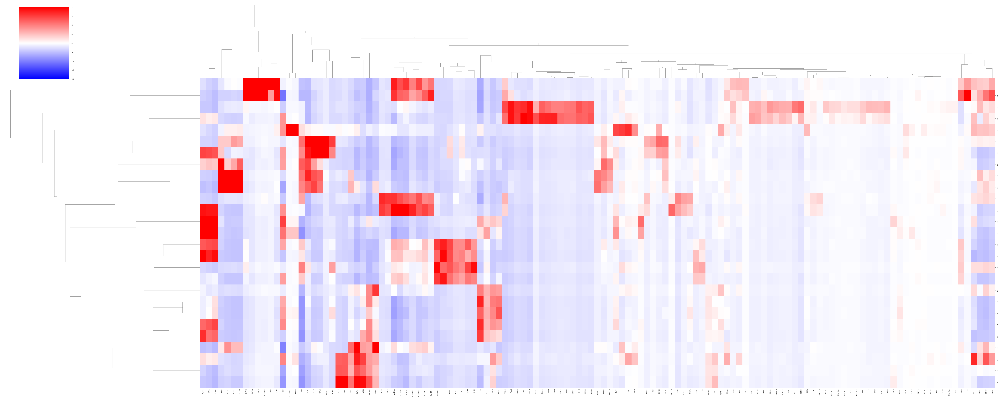

In [17]:
if z_score_cells == True and z_score_cluster == False:   
    
    ## calculate means for each cluster and export to dataframe
    all_cells_df_clean = adata.obs[pheno_heat] 
    clusters_cells_clean = list(set(all_cells_df_clean.values))
    
    ## remove -1 cells not belonging to any cluster
    if cluster_minus_one_present == True:
        clusters_cells_clean.remove(-1) #optional if -1 in heatmap
        
    ## create empty dataframe
    marker_df = pd.DataFrame(index=clusters_cells_clean, columns=marker_genes_filtered)
    marker_df = marker_df.astype('float')
 
    ## select imputed or raw layer   
    if layer_heat_imputed == True:
        gene_expression_zscored = pd.DataFrame(scipy.stats.zscore(adata.layers['imputed'],axis=0), index=adata.obs_names, columns=adata.var_names) # create zscored gene expression df
    else:
        gene_expression_zscored = pd.DataFrame(scipy.stats.zscore(adata.X.toarray(), axis=0), index=adata.obs_names, columns=adata.var_names)
        
    for i in clusters_cells_clean:
        print('Cluster: ',i)
        cluster_adata = all_cells_df_clean[all_cells_df_clean==i]
        cluster_adata2 = gene_expression_zscored.loc[cluster_adata.index, :]
        for j in marker_genes_filtered:
            marker_df.loc[i,:] = np.mean(cluster_adata2, axis=0)

    %matplotlib inline

    # drop na columns
    marker_df = marker_df.dropna(axis=1, how='any', thresh=None, subset=None, inplace=False)

    # drop all zero columns
    non_zero = (marker_df != 0).any(axis=0)
    marker_df = marker_df[non_zero.index[non_zero]]#drop zeros columns bc SD will be 0 --> cant divide with 0 for z score

    # set color scale
    divnorm = colors.DivergingNorm(vmin=-2, vcenter=0, vmax=2)
    marker_df = marker_df.astype(float) #  gene expression means x pheno cluster matrix
    sns.set(font_scale = 1) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
    sns.clustermap(marker_df, cmap='bwr', col_cluster=True, figsize=(100,40), vmax=3, z_score=None, norm=divnorm) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib

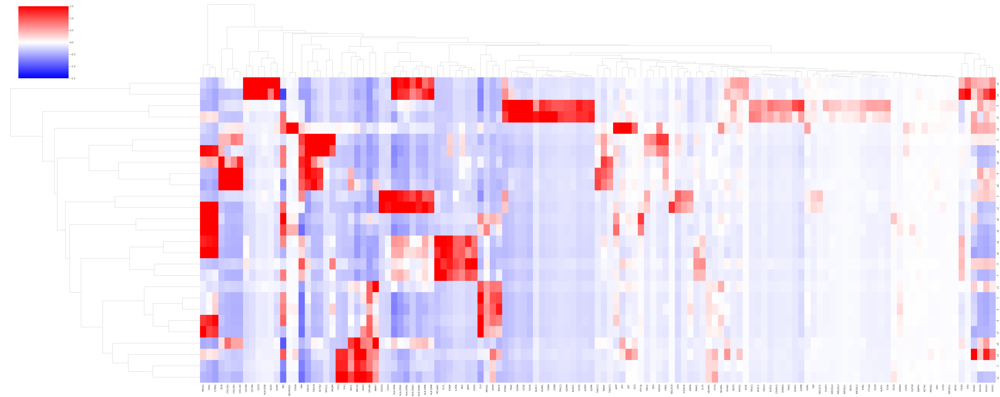

In [18]:
# set color scale
divnorm = colors.DivergingNorm(vmin=-1.5, vcenter=0, vmax=1.5)
marker_df = marker_df.astype(float) #  gene expression means x pheno cluster matrix
sns.set(font_scale = 1.5) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
sns.clustermap(marker_df, cmap='bwr', col_cluster=True, figsize=(100,40), vmax=3, z_score=None, norm=divnorm) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib

In [19]:
if z_score_cluster ==True:
    ## calculate means for each cluster and export to dataframe
    all_cells_df_clean = adata.obs[pheno_heat] 
    clusters_cells_clean = list(set(all_cells_df_clean.values))
    
    ## remove -1 cells not belonging to any cluster
    if cluster_minus_one_present == True:
        clusters_cells_clean.remove(-1) #optional if -1 in heatmap
    
    ## create empty dataframe
    marker_df = pd.DataFrame(index=clusters_cells_clean, columns=marker_genes_filtered)
    marker_df = marker_df.astype('float') 
    
    ## select imputed or raw layer 
    if layer_heat_imputed == True:
        gene_expression_zscored = pd.DataFrame(
        adata.layers['imputed'], index=adata.obs_names, columns=adata.var_names)
    else:
        gene_expression_zscored = pd.DataFrame(
        adata.X.toarray(), index=adata.obs_names, columns=adata.var_names)

    for i in clusters_cells_clean:
        print('Cluster: ',i)
        cluster_adata = all_cells_df_clean[all_cells_df_clean==i]
        cluster_adata2 = gene_expression_zscored.loc[cluster_adata.index, :]
        for j in marker_genes_filtered:
            marker_df.loc[i,:] = np.mean(cluster_adata2, axis=0)
            
    %matplotlib inline
    
    # drop na columns
    marker_df = marker_df.dropna(axis=1, how='any', thresh=None, subset=None, inplace=False)
    
    # drop all zero columns
    non_zero = (marker_df != 0).any(axis=0)
    marker_df = marker_df[non_zero.index[non_zero]]#drop zeros columns bc SD will be 0 --> cant divide with 0 for z score
    
    # set color scale
    divnorm = colors.DivergingNorm(vmin=-2, vcenter=0, vmax=2)
    marker_df = marker_df.astype(float) #  gene expression means x pheno cluster matrix
    sns.set(font_scale = 1) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
    sns.clustermap(marker_df, cmap='bwr', col_cluster=True, figsize=(50,30), vmax=1.5, z_score= 1, norm=divnorm) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib

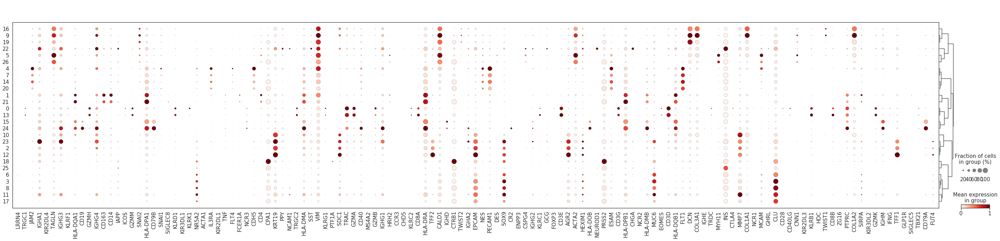

In [20]:
#dotplot
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, dendrogram=True, standard_scale='var')

In [25]:
markers.values()

dict_values(['PTPRC', ['CD3D', 'CD3E', 'CD3G', 'TRAC', 'TRBC1', 'TRBC2', 'TRGC1', 'TRGC2', 'TRDC'], ['CD79A', 'CD79B', 'CD19'], ['SDC1', 'IGHG1', 'IGHG2', 'IGHG3', 'IGHG4', 'IGHA1', 'IGHA2', 'IGHM', 'IGHE'], ['CD68', 'ITGAM', 'CD14'], ['CSF3R', 'CXCR1', 'CXCR2', 'FUT4'], ['TPSAB1', 'TPSAB2', 'TPSB2', 'TPSB1', 'KIT'], ['NCAM1', 'NCR1', 'NCR2', 'NCR3'], ['IRF4', 'IRF8', 'TCF4', 'ZEB2', 'IRF7'], ['PECAM1', 'ESAM', 'JAM2', 'FLT4', 'CHD5'], ['MYH11', 'VIM', 'COL3A1', 'COL1A2', 'COL1A1'], ['GLP1R', 'GLPR2R', 'GHRL', 'SST', 'IAPP', 'INS', 'GCG', 'PPY'], ['EPCAM', 'CDH1', 'EGFR', 'SOX9', 'MUC6', 'MUC5', 'KRT19']])

In [42]:
adata

AnnData object with n_obs × n_vars = 152991 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'v

In [ ]:
#dotplot
markers = {'leukocyte':['PTPRC'],
           'T-cell': ['CD3D','CD3E','CD3G','TRAC','TRBC1','TRBC2','TRGC1','TRGC2','TRDC'],
           'B-cell': ['CD79A','CD79B','CD19'],
           'plasma-cell':['SDC1','IGHG1','IGHG2','IGHG3','IGHG4','IGHA1','IGHA2','IGHM','IGHE'],
           'myeloid': ['CD68','ITGAM','CD14'],
          'granulocyte':['CSF3R','CXCR1','CXCR2','FUT4'],
          'mast-cell':['TPSAB1','TPSAB2','TPSB2','TPSB1','KIT'],
          'NK-cell':['NCAM1','NCR1','NCR2','NCR3'],
          'plasmacytoid-DC':['IRF4','IRF8','TCF4','ZEB2','IRF7'],
           'endothelial-cell':['PECAM1','ESAM','JAM2','FLT4','CHD5'],
           '(myo)fibroblast':['MYH11','VIM','COL3A1','COL1A2','COL1A1'],
           'neuroendocrine-cell':['GLP1R','GLPR2R','GHRL','SST','IAPP','INS','GCG','PPY'],
           'epithelial':['EPCAM','CDH1','EGFR','SOX9','MUC6','MUC5','KRT19']}

for i in markers.keys():
    markers[i] = [i for i in markers[i] if i in adata.var_names]
    

sns.set(font_scale = 1.5)
sns.set_style('white')
#sc.tl.dendrogram(adata,pheno_heat)
sc.pl.dotplot(adata, markers, pheno_heat,  standard_scale='var', use_raw=False)

In [32]:
markers

{'leukocyte': ['PTPRC'],
 'T-cell': ['CD3D',
  'CD3E',
  'CD3G',
  'TRAC',
  'TRBC1',
  'TRBC2',
  'TRGC1',
  'TRGC2',
  'TRDC'],
 'B-cell': ['CD79A', 'CD79B', 'CD19'],
 'plasma-cell': ['SDC1',
  'IGHG1',
  'IGHG2',
  'IGHG3',
  'IGHG4',
  'IGHA1',
  'IGHA2',
  'IGHM',
  'IGHE'],
 'myeloid': ['CD68', 'ITGAM', 'CD14'],
 'granulocyte': ['CSF3R', 'CXCR1', 'CXCR2', 'FUT4'],
 'mast-cell': ['TPSAB1', 'TPSB2', 'KIT'],
 'NK-cell': ['NCAM1', 'NCR1', 'NCR2', 'NCR3'],
 'plasmacytoid-DC': ['IRF4', 'IRF8', 'TCF4', 'ZEB2', 'IRF7'],
 'endothelial-cell': ['PECAM1', 'ESAM', 'JAM2', 'FLT4', 'CHD5'],
 '(myo)fibroblast': ['MYH11', 'VIM', 'COL3A1', 'COL1A2', 'COL1A1'],
 'neuroendocrine-cell': ['GLP1R', 'GHRL', 'SST', 'IAPP', 'INS', 'GCG', 'PPY'],
 'epithelial': ['EPCAM', 'CDH1', 'EGFR', 'SOX9', 'MUC6', 'KRT19']}

In [21]:
# save to csv
marker_df.to_csv(save_path_heat) # otherwise will write a first column with index 0
save_path_heat

# assign cell identities

'/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210216_phenovar_k60_heatmap_zscore_cells_reanalyis.csv'

# split adata

In [24]:
# create lists of TIL classes
#42 leuko or endocrine?

leuko_list = [15,24,0,13,1,21]
leuko = ['leukocyte']*len(leuko_list)
fibro_list = [5,26,19,9,16]
fibro = ['fibroblast and myocytes']*len(fibro_list)
endothelial_list = [14,20,4,7]
endothelial = ['endothelial cell']*len(endothelial_list)
epithelial_list = [18,25,11,3,6,8,17,10,23,2,12]
epithelial = ['epithelial cell']*len(epithelial_list)
endocrine_list = [22]
endocrine = ['neuroendocrine']*len(endocrine_list)
nan_list = []
nan = ['NaN']*len(nan_list)
#names and paths
TIL_subset_name = 'major_subsets'
csv_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210426_crosstab_reanalysis' #leave out .csv as name will be automatically appended
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210216_reanalysis.h5ad' #can be the same as input adata bc will be appended
load_adata = True

#parameters
clustering = 'pheno_var_k60'


In [25]:
if load_adata == True:
    adata=sc.read(adata_path)

In [26]:
#create dictionaries
dict0 = dict(zip(leuko_list, leuko))
dict1 = dict(zip(fibro_list, fibro))
dict2 = dict(zip(endothelial_list, endothelial))
dict3 = dict(zip(epithelial_list, epithelial))
dict4 = dict(zip(endocrine_list, endocrine))



# merging of dictionaries
dict1.update(dict0)
dict1.update(dict2)
dict1.update(dict3)
dict1.update(dict4)


TIL_classes_pheno_list_ndf_dict = dict1

In [27]:
#transform clusters to classes with dict
adata.obs[TIL_subset_name] = adata.obs[clustering].map(TIL_classes_pheno_list_ndf_dict)

... storing 'major_subsets' as categorical


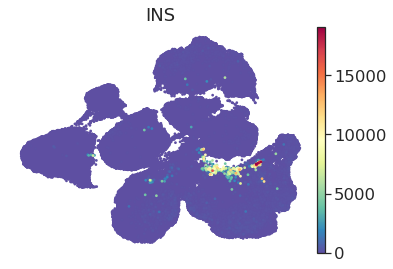

In [28]:
sc.pl.umap(adata, color = ['INS'], s = 30, cmap='Spectral_r', legend_fontsize = 10, vmin=0, layer=None)

In [71]:
color_map_subtypes = [ '#1CE6FF','#FF34FF','#FF4A46','#008941',
 '#FFFF00']

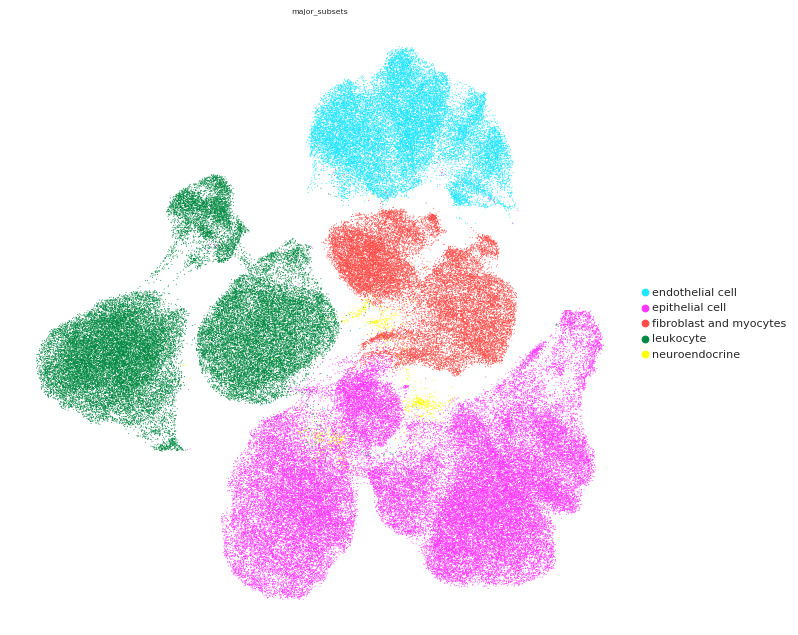

In [72]:
#show TIL classes in umap
sc.pl.umap(adata, color = [TIL_subset_name],layer='imputed', s = 3, palette=color_map_subtypes,legend_fontsize = 10, vmin=0)

In [30]:
#calculate cluster and subset frequencies per samples
cluster_frequencies = pd.crosstab(adata.obs[clustering], adata.obs['batch']).apply(lambda r: r/r.sum(), axis=0)
celltype_frequencies = pd.crosstab(adata.obs[TIL_subset_name], adata.obs['batch']).apply(lambda r: r/r.sum(), axis=0)

In [31]:
#list all crosstabs to display and save
TIL_frequency_subsets = [cluster_frequencies,celltype_frequencies]
subset_names_list = ['cluster_frequencies','celltype_frequencies']

In [32]:
#remove minus one cluster
TIL_frequency_subsets_clean = []

for i in TIL_frequency_subsets:
    if -1 in i.index: #only applies -1 dropping to dataframes containing -1 cluster
        i = i.drop(-1, axis=0)
        TIL_frequency_subsets_clean.append(i)
    else:
        TIL_frequency_subsets_clean.append(i)

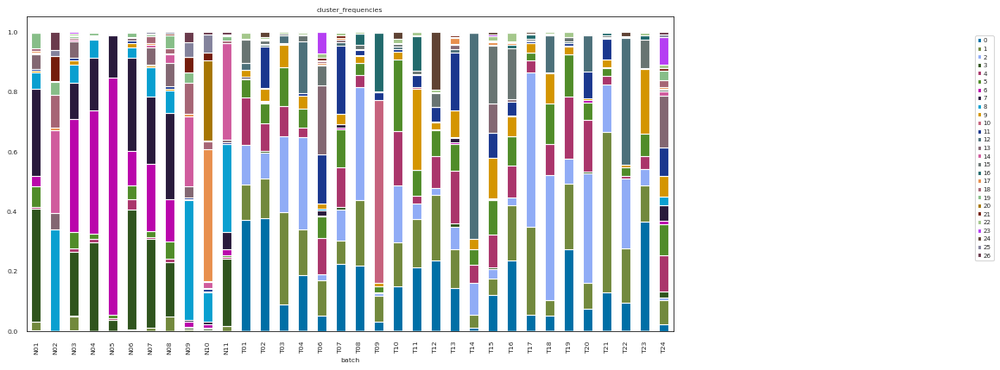

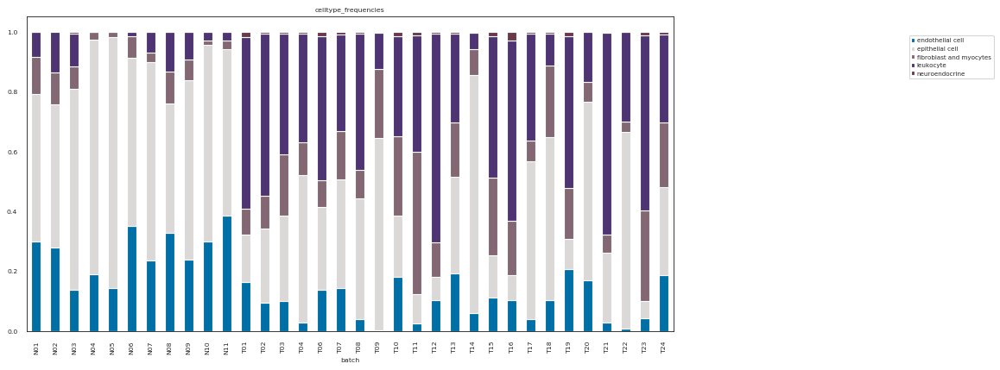

In [39]:
sns.set_style('white')
for i,v in enumerate(TIL_frequency_subsets_clean):
    v.T.plot(kind='bar', stacked=True,
          figsize=(12,6), legend= False, cmap= color_map_clusters_plt)
    plt.legend(bbox_to_anchor=(0.5, 0.2, 1, 0.75))
    plt.title(subset_names_list[i])

In [34]:
#save crosstabs
TIL_frequency_subsets_clean[0].to_csv(csv_save_path+'clusters_x_samples_reanalysis.csv')
print('save to', csv_save_path+'clusters_x_samples_reanalysis.csv')
TIL_frequency_subsets_clean[1].to_csv(csv_save_path+'TILclasses_x_samples_reanalysis.csv')
print('save to', csv_save_path+'TILclasses_x_samples_reanalysis.csv')

save to /data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210426_crosstab_reanalysisclusters_x_samples_reanalysis.csv
save to /data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210426_crosstab_reanalysisTILclasses_x_samples_reanalysis.csv


## split adata

In [73]:
fibro[0]

'fibroblast and myocytes'

In [74]:
#split adata in subsets
adata_leuko = adata[adata.obs[TIL_subset_name]==leuko[0]]
adata_fibromyo = adata[adata.obs[TIL_subset_name]==fibro[0]]
adata_endothelial = adata[adata.obs[TIL_subset_name]==endothelial[0]]
adata_epi = adata[adata.obs[TIL_subset_name]==epithelial[0]]
adata_endocrine = adata[adata.obs[TIL_subset_name]==endocrine[0]]

In [97]:
#initial data (performed med lib size+log1p on data which was alreadt med lib size + log1p normalized)
adata_leuko

View of AnnData object with n_obs × n_vars = 42980 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 

In [75]:
#data after only one round of med lib size + log1p normalization
adata_leuko

View of AnnData object with n_obs × n_vars = 42964 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 

In [98]:
#initial data (performed med lib size+log1p on data which was alreadt med lib size + log1p normalized)
adata_fibromyo

View of AnnData object with n_obs × n_vars = 22445 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 

In [76]:
#data after only one round of med lib size + log1p normalization
adata_fibromyo

View of AnnData object with n_obs × n_vars = 22081 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 

In [99]:
#initial data (performed med lib size+log1p on data which was alreadt med lib size + log1p normalized)
adata_endothelial

View of AnnData object with n_obs × n_vars = 24052 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 

In [77]:
#data after only one round of med lib size + log1p normalization
adata_endothelial

View of AnnData object with n_obs × n_vars = 24038 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 

In [100]:
#initial data (performed med lib size+log1p on data which was alreadt med lib size + log1p normalized)
adata_epi

View of AnnData object with n_obs × n_vars = 62474 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 

In [78]:
#data after only one round of med lib size + log1p normalization
adata_epi

View of AnnData object with n_obs × n_vars = 62871 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 

In [101]:
#initial data (performed med lib size+log1p on data which was alreadt med lib size + log1p normalized)
adata_endocrine

View of AnnData object with n_obs × n_vars = 1040 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', '

In [79]:
#data after only one round of med lib size + log1p normalization
adata_endocrine

View of AnnData object with n_obs × n_vars = 1037 × 20962
    obs: 'batch', 'primary_tumor', 'LogProb_emptydrops', 'PValue_emptydrops', 'FDR_emptydrops', 'Limited', 'total_molecules', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'percent_mito', 'n_counts', 'pheno', 'true_cell_emptydrops', 'empty_droplet_sig', 'doublets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', '

## save adatas

In [81]:
leuko_suffix = 'leukocytes'
fibromyo_suffix = 'fibroblast_myocytes'
endothelial_suffix= 'endothelial'
epithelial_suffix = 'epithelial'
endocrine_suffix = 'endocrine'

adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_phenok60_210426_reanalysis_'

In [82]:
print(adata_save_path+ leuko_suffix +'.h5ad')
print(adata_save_path + fibromyo_suffix +'.h5ad')
print(adata_save_path + endothelial_suffix +'.h5ad')
print(adata_save_path + epithelial_suffix + '.h5ad')
print(adata_save_path + endocrine_suffix +'.h5ad')

/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_phenok60_210426_reanalysis_leukocytes.h5ad
/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_phenok60_210426_reanalysis_fibroblast_myocytes.h5ad
/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_phenok60_210426_reanalysis_endothelial.h5ad
/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-

In [83]:
#save files
adata_leuko.write(adata_save_path + leuko_suffix +'.h5ad')
adata_fibromyo.write(adata_save_path + fibromyo_suffix +'.h5ad')
adata_endothelial.write(adata_save_path + endothelial_suffix +'.h5ad')
adata_epi.write(adata_save_path + epithelial_suffix + '.h5ad')
adata_endocrine.write(adata_save_path + endocrine_suffix +'.h5ad')

# compare leukocyte adatas which were med lib size + log1p normalized once vs med lib size + log1p normalized twice

In [87]:
adata_norm_once_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_phenok60_210426_reanalysis_leukocytes.h5ad'
adata_norm_twice_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210216_leukocytes.h5ad'

In [88]:
adata_norm_once = sc.read(adata_norm_once_path)
adata_norm_twice = sc.read(adata_norm_twice_path)

In [100]:
print('cells retrieved in single normalized approach (percent of double normalized)')
print(100*len(set(adata_norm_twice.obs_names).intersection(set(adata_norm_once.obs_names)))/len(set(adata_norm_twice.obs_names)))

cells retrieved in single normalized approach (percent of double normalized)
99.77664029781293


In [98]:
len(set(adata_norm_twice.obs_names).intersection(set(adata_norm_once.obs_names)))

42884